In [1]:
import torch
import torch.nn.functional as F
import argparse
import numpy as np


torch.backends.cuda.matmul.allow_tf32 = True
torch.backends.cudnn.allow_tf32 = True

from torchvision.utils import save_image
from diffusion import create_diffusion

from diffusers.models import AutoencoderKL
from models import VDT_models
from mask_generator import VideoMaskGenerator
from utils import load_checkpoint

In [2]:
parser = argparse.ArgumentParser()
parser.add_argument("--model", type=str, choices=list(VDT_models.keys()), default="VDT-L/2")
parser.add_argument("--vae", type=str, choices=["ema", "mse"], default="ema")
parser.add_argument("--image-size", type=int, default=256)
parser.add_argument("--f", type=str, default=None)
parser.add_argument("--num-classes", type=int, default=1)
parser.add_argument("--batch_size", type=int, default=8)
parser.add_argument("--cfg-scale", type=float, default=4.0)
parser.add_argument("--num-sampling-steps", type=int, default=16) # Set higher for better results! (max 1000)
parser.add_argument("--seed", type=int, default=0)
parser.add_argument("--num_frames", type=int, default=16)
parser.add_argument("--ckpt", type=str, default="model.pt",
                    help="Optional path to a VDT checkpoint.")
parser.add_argument('--device', default='cuda')
args = parser.parse_args()

In [3]:
device = torch.device(args.device)
# Setup PyTorch:
torch.manual_seed(args.seed)
torch.set_grad_enabled(False)

# Load model:
latent_size = args.image_size // 8
additional_kwargs = {'num_frames': args.num_frames,
    'mode': 'video'} 
model = VDT_models[args.model](
    input_size=latent_size,
    num_classes=args.num_classes,
    **additional_kwargs
)

model, _ = load_checkpoint(model, args.ckpt)
model = model.to(device)   
model.eval()  # important!
diffusion = create_diffusion(str(args.num_sampling_steps))
vae = AutoencoderKL.from_pretrained(f"stabilityai/sd-vae-ft-{args.vae}").to(device)

torch.Size([8, 16, 3, 256, 256])
torch.Size([128, 3, 256, 256])


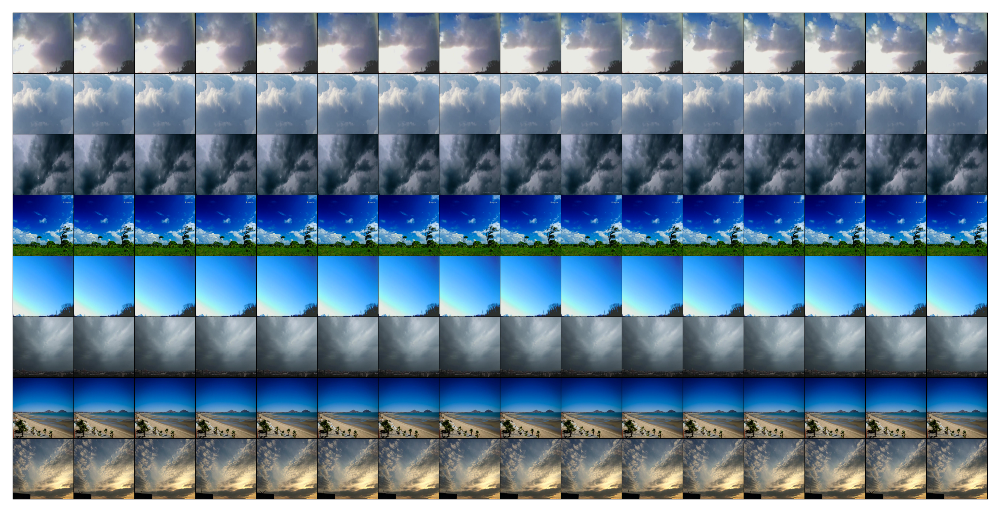

In [4]:
import matplotlib.pyplot as plt
import matplotlib.image as mpimg

x = torch.load("test_video.pt").to(device)
B, T, C, H, W = x.shape
print(x.shape)
x = x.view(-1, C, H, W).to(device=device)
save_image(x, "input.png", nrow=16, normalize=True, value_range=(-1, 1))
print(x.shape)


img = mpimg.imread('input.png')

plt.figure(figsize=(10, 8), dpi=500)
plt.imshow(img)
plt.axis('off') 
plt.show()

In [5]:
choice = {
    'predict': 0,
    'backward': 1,
    'interpolation': 2,
    'unconditional': 3,
    'one_frame': 4,
    'arbitrary_interpolation': 5,
    'spatial_temporal': 6
}
choice_name = input("Please select task type: ")
choice_idx = choice[choice_name]

In [6]:
print(x.shape)
raw_x = x
with torch.no_grad():
    # Map input images to latent space + normalize latents:
    x = vae.encode(x).latent_dist.sample().mul_(0.18215)
x = x.view(-1, args.num_frames, 4, x.shape[-2], x.shape[-1])
print(x.shape)
print(latent_size)
z = torch.randn(B, args.num_frames, 4, latent_size, latent_size, device=device)


generator = VideoMaskGenerator((x.shape[-4], x.shape[-2], x.shape[-1]))
mask = generator(B, device, idx=choice_idx)

sample_fn = model.forward

# Sample images:

z = z.permute(0, 2, 1, 3, 4)
samples = diffusion.p_sample_loop(
    sample_fn, z.shape, z, clip_denoised=False, progress=True, device=device,
    raw_x=x, mask=mask
)

# abc->acb->bac
# samples = samples.permute(0, 2, 1, 3, 4)
samples = samples.permute(1, 0, 2, 3, 4) * mask + x.permute(2, 0, 1, 3, 4) * (1-mask)

samples = samples.permute(1, 2, 0, 3, 4) # 4, 16, 8, 32, 32 -> 16 8 4
samples = samples.reshape(-1, 4, latent_size, latent_size) / 0.18215


decoded_chunks = []
chunk_size = 256

num_chunks = (samples.shape[0] + chunk_size - 1) // chunk_size
for i in range(num_chunks):
    start_idx = i * chunk_size
    end_idx = min((i + 1) * chunk_size, samples.shape[0])
    chunk = samples[start_idx:end_idx]
    
    decoded_chunk = vae.decode(chunk).sample
    decoded_chunks.append(decoded_chunk)


samples = torch.cat(decoded_chunks, dim=0)


samples = samples.reshape(-1, args.num_frames, samples.shape[-3], samples.shape[-2], samples.shape[-1])

mask = F.interpolate(mask.float(), size=(raw_x.shape[-2], raw_x.shape[-1]), mode='nearest')
mask = mask.unsqueeze(0).repeat(3,1,1,1,1).permute(1, 2, 0, 3, 4) 

raw_x = raw_x.reshape(-1, args.num_frames, raw_x.shape[-3], raw_x.shape[-2], raw_x.shape[-1])
raw_x = raw_x * (1 - mask)

torch.Size([128, 3, 256, 256])
torch.Size([8, 16, 4, 32, 32])
32


  0%|          | 0/16 [00:00<?, ?it/s]

torch.Size([8, 32, 3, 256, 256])


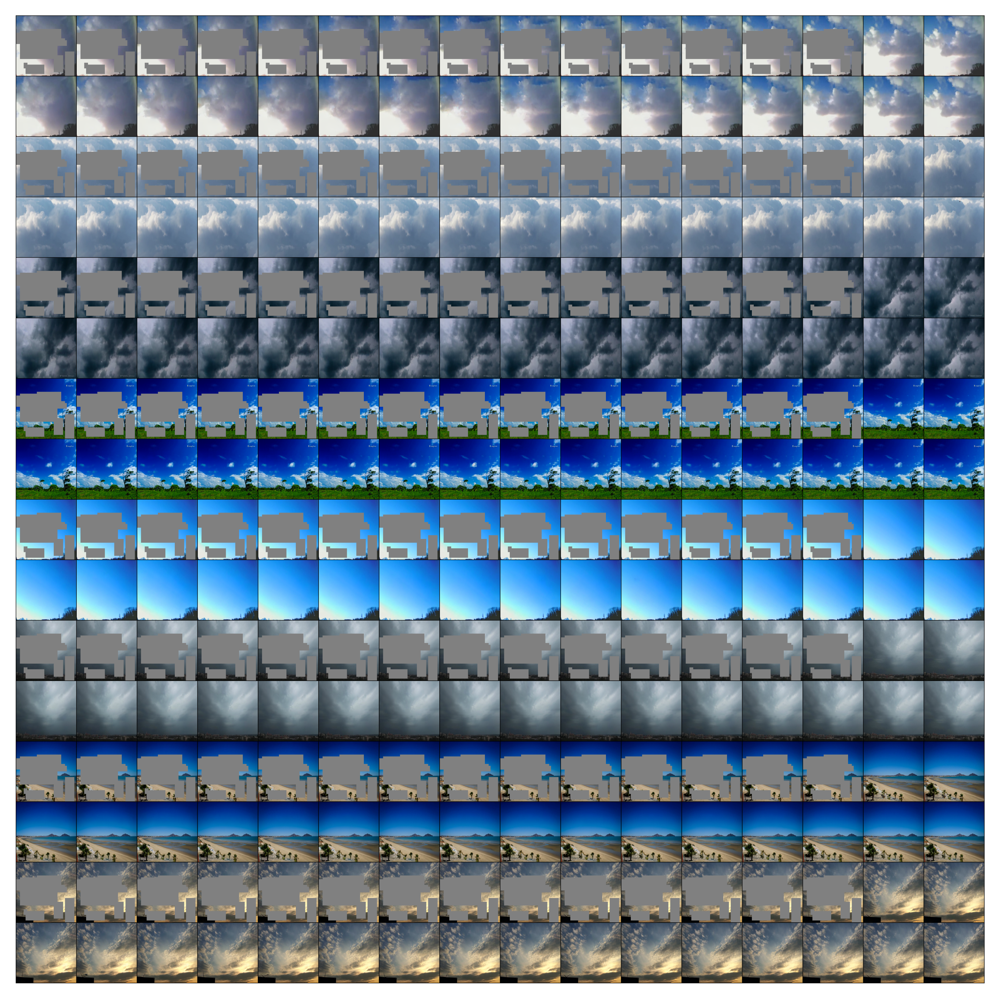

In [7]:
samples = torch.cat([raw_x, samples], dim=1)
print(samples.shape)
save_image(samples.reshape(-1, samples.shape[-3], samples.shape[-2], samples.shape[-1]), "output.png", nrow=16, normalize=True, value_range=(-1, 1))

img = mpimg.imread('output.png')

plt.figure(figsize=(10, 8), dpi=500)
plt.imshow(img)
plt.axis('off') 
plt.show()